# Validate DINOv3 CHM with airborne lidar grids (LVIS): plots `stats`

#### Read in large CSV and plot LVIS validation results - this is done on the `dm_10m` version of the results

#### Note: works in `ILAB Kernel (R) 2026` - but in `ILAB Kernel (R) v2026 (with tidyterra)` --> problem with getting crs() of dm 10m CHM

Paul Montesano  
Jan 2026

In [1]:
library(dplyr)
library(data.table)
library(tidyr)
library(ggplot2)
library(stringr)
library(terra)
library(patchwork)
library(scales)

Warning message:
“package ‘dplyr’ was built under R version 4.4.3”

Attaching package: ‘dplyr’


The following objects are masked from ‘package:stats’:

    filter, lag


The following objects are masked from ‘package:base’:

    intersect, setdiff, setequal, union


Warning message:
“package ‘data.table’ was built under R version 4.4.3”

Attaching package: ‘data.table’


The following objects are masked from ‘package:dplyr’:

    between, first, last


Warning message:
“package ‘tidyr’ was built under R version 4.4.3”
Warning message:
“package ‘ggplot2’ was built under R version 4.4.3”
Warning message:
“package ‘stringr’ was built under R version 4.4.3”
terra 1.7.78


Attaching package: ‘terra’


The following object is masked from ‘package:tidyr’:

    extract


The following object is masked from ‘package:data.table’:

    shift


Warning message:
“package ‘patchwork’ was built under R version 4.4.3”

Attaching package: ‘patchwork’


The following object is masked from ‘package:terr

In [2]:
library(ggspatial)

Warning message:
“package ‘ggspatial’ was built under R version 4.4.3”


In [2]:
#VAL_DF = '/explore/nobackup/projects/above/misc/ABoVE_Shrubs/validation/chm/dinov3/4.3.2.5/dm_10m/val_df_LVISRH080_RH085_RH090.csv.gz'

In [3]:
OUT_RESULTS_DIR = "/explore/nobackup/projects/above/misc/ABoVE_Shrubs/paper_figs" # validation/chm/dinov3/4.3.2.5/dm_10m/plots"

In [4]:
CSV_SET = 'LVISRH085_RH090_RH098'
CSV_SET = 'LVISRH075_RH085_RH098'

In [5]:
# df_val <- fread(cmd = 'gunzip -c /explore/nobackup/projects/above/misc/ABoVE_Shrubs/validation/chm/dinov3/4.3.2.5/dm_10m/val_df_LVISRH080_RH085_RH090.csv.gz')
df_val <- fread(cmd = paste0('gunzip -c /explore/nobackup/projects/above/misc/ABoVE_Shrubs/validation/chm/dinov3/4.3.2.5/dm_10m/val_df_',CSV_SET,'.csv.gz'))
dim(df_val)

[1] 85109073       19

In [6]:
colnames(df_val %>% select(contains('RH')))

[1] "ht_m_ref_RH075" "ht_m_ref_RH085" "ht_m_ref_RH098"

In [7]:
min(df_val$ht_m_src)

[1] 0

In [8]:
min(df_val$ht_m_ref_RH085)

[1] -0.08

# Map

In [9]:
source('/home/pmontesa/code/above-shrubs/notebooks/validate_chm_dinov3_functions.r')

In [10]:
# Usage example:
val_csv_dir <- "/explore/nobackup/projects/above/misc/ABoVE_Shrubs/validation/chm/dinov3/4.3.2.5/dm_10m/LVISRH075_RH085_RH098"
lvis_grid_dir <- "/explore/nobackup/people/pmontesa/userfs02/data/LVIS/2019/output/metrics/30"

# Get LVIS mosaic for a catid
lvis_mosaic <- get_lvis_mosaic_for_catid(
  catid = "1030010019B16500",
  val_csv_dir = val_csv_dir,
  lvis_grid_dir = lvis_grid_dir,
    LVIS_RH_STR = 'RH075',
  verbose = TRUE
)

# # With crop extent and target CRS (to match your predicted CHM)
# lvis_mosaic <- get_lvis_mosaic_for_catid(
#   catid = "104001004FBF8F00",
#   val_csv_dir = val_csv_dir,
#   lvis_grid_dir = lvis_grid_dir,
#   crop_extent = ext(r_native),  # Use your CHM extent
#   target_crs = crs(r_native),    # Use your CHM CRS
#   verbose = TRUE
# )

# # Then use it in plotting
# if (!is.null(lvis_mosaic)) {
#   lvis_df <- as.data.frame(lvis_mosaic, xy = TRUE, na.rm = TRUE)
#   colnames(lvis_df) <- c("x", "y", "value")
#   # ... create plot
# }


=== LVIS  RH075  Mosaic Creation ===
Searching for catid: 1030010019B16500 in /explore/nobackup/projects/above/misc/ABoVE_Shrubs/validation/chm/dinov3/4.3.2.5/dm_10m/LVISRH075_RH085_RH098 
Found 4 validation CSV files
Found 4 unique LVIS flightlines:
   LVISF2_ABoVE2019_0727_R2003_066039 
   LVISF2_ABoVE2019_0727_R2003_066255 
   LVISF2_ABoVE2019_0728_R2003_060538 
   LVISF2_ABoVE2019_0728_R2003_061718 
Found LVIS  RH075  grid: LVISF2_ABoVE2019_0727_R2003_066039_RH075_mean_30m.tif 
Found LVIS  RH075  grid: LVISF2_ABoVE2019_0727_R2003_066255_RH075_mean_30m.tif 
Found LVIS  RH075  grid: LVISF2_ABoVE2019_0728_R2003_060538_RH075_mean_30m.tif 
Found LVIS  RH075  grid: LVISF2_ABoVE2019_0728_R2003_061718_RH075_mean_30m.tif 
Loading 4 LVIS  RH075  grid(s)...
Creating mosaic from 4 grids...
Mosaic created
Mosaic dimensions: 1380 4801 
Mosaic extent: -2756520 -2612490 4295150 4336550 
Mosaic CRS: unnamed 
LVIS mosaic ready




=== CHM Processing ===
Searching for catid: 104001004F54B700 in /explore/nobackup/projects/above/misc/ABoVE_Shrubs/chm/2026_chm/4.3.2.5/dm_10m 
Using CHM file: WV03_20190817_M1BS_104001004F54B700-chm-dm-10m.tif 
CHM CRS: NAD83 / Alaska Albers 
CHM dimensions: 9197 3618 
Applying crop with buffer: 500 x 500 pixels
Display extent: -417715.2 -412715.2 1635433 1640433 
Crop extent (with buffer): -418090.2 -412340.2 1635058 1640808 
Cropped CHM dimensions: 575 575 
CHM extent: -418095, -412345, 1635055, 1640805 

=== Source Processing ===
Searching for catid: 104001004F54B700 in /explore/nobackup/projects/above/misc/ABoVE_Shrubs/srlite/002m_2023 
Using source file: WV03_20190817_M1BS_104001004F54B700-sr-02m.tif 
Loading source raster...
Source CRS: WGS 84 / UTM zone 3N 
Source dimensions: 44767 10785 
Source bands: 8 
Source and CHM in same CRS: FALSE 
Cropping source to buffered CHM extent...
CHM extent in source CRS: 609230 615861 7147035 7153655 
Reprojecting cropped source to CHM CRS..

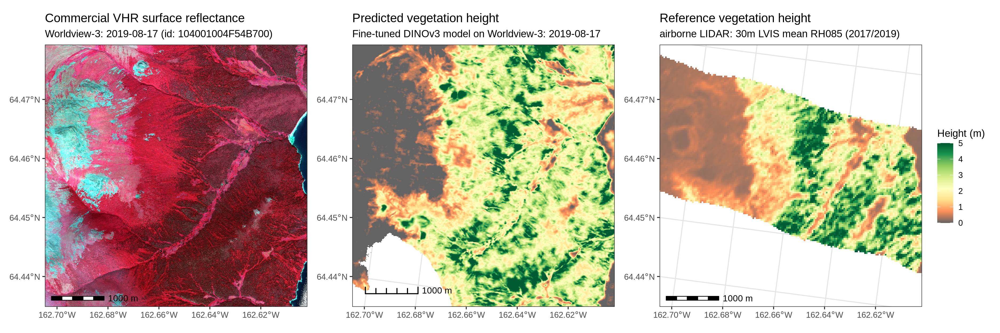

In [8]:
options(repr.plot.width = 15, repr.plot.height = 5, repr.plot.res = 250, warn=-1)

# With LVIS reference
p_show_ref_104001004F54B700 <- map_raster_by_catid(
  catid = '104001004F54B700',#'1030010019B16500',
  chm_dir = "/explore/nobackup/projects/above/misc/ABoVE_Shrubs/chm/2026_chm/4.3.2.5/dm_10m",
  source_dir = "/explore/nobackup/projects/above/misc/ABoVE_Shrubs/srlite/002m_2023",
  val_csv_dir = "/explore/nobackup/projects/above/misc/ABoVE_Shrubs/validation/chm/dinov3/4.3.2.5/dm_10m/LVISRH075_RH085_RH098",
  lvis_grid_dir = "/explore/nobackup/people/pmontesa/userfs02/data/LVIS/2019/output/metrics/30",
  lvis_rh_str = 'RH085',
  use_forest_ht_cmap = TRUE,
  fill_label = "Height (m)",
  crop_center_lon = -162.66,
  crop_center_lat = 64.46,
  crop_width_pixels = 500,
  crop_height_pixels = 500,
                         chm_max_value = 5,
                         edge_buffer = 1.15,  # Crop 15% larger, display smaller
  SHOW_REF = TRUE,
  SCALE_FACTOR = 0.1
)
print(p_show_ref_104001004F54B700)

In [ ]:
options(repr.plot.width = 15, repr.plot.height = 5, repr.plot.res = 250, warn=-1)

# With LVIS reference
p_show_ref_104001004FBF8F00 <- map_raster_by_catid(
  catid = "104001004FBF8F00",
  chm_dir = "/explore/nobackup/projects/above/misc/ABoVE_Shrubs/chm/2026_chm/4.3.2.5/dm_10m",
  source_dir = "/explore/nobackup/projects/above/misc/ABoVE_Shrubs/srlite/002m_2023",
  val_csv_dir = "/explore/nobackup/projects/above/misc/ABoVE_Shrubs/validation/chm/dinov3/4.3.2.5/dm_10m/LVISRH075_RH085_RH098",
  lvis_grid_dir = "/explore/nobackup/people/pmontesa/userfs02/data/LVIS/2019/output/metrics/30",
    lvis_rh_str = 'RH085',
  use_forest_ht_cmap = TRUE,
  fill_label = "Height (m)",
  crop_center_lon = -146.005,
  crop_center_lat = 66.5,
  crop_width_pixels = 500,
  crop_height_pixels = 500,
                         chm_max_value = 5,
                         edge_buffer = 1.15,  # Crop 15% larger, display smaller
  SHOW_REF = TRUE,
  SCALE_FACTOR = 0.1
)
print(p_show_ref_104001004FBF8F00)

In [ ]:
options(repr.plot.width = 15, repr.plot.height = 5, repr.plot.res = 250, warn=-1)

# With LVIS reference
p_show_ref_103001006E5C5200 <- map_raster_by_catid(
  catid = "103001006E5C5200",
  chm_dir = "/explore/nobackup/projects/above/misc/ABoVE_Shrubs/chm/2026_chm/4.3.2.5/dm_10m",
  source_dir = "/explore/nobackup/projects/above/misc/ABoVE_Shrubs/srlite/002m_2023",
  val_csv_dir = "/explore/nobackup/projects/above/misc/ABoVE_Shrubs/validation/chm/dinov3/4.3.2.5/dm_10m/LVISRH075_RH085_RH098",
  lvis_grid_dir = "/explore/nobackup/people/pmontesa/userfs02/data/LVIS/2019/output/metrics/30",
    lvis_rh_str = 'RH085',
  use_forest_ht_cmap = TRUE,
  fill_label = "Height (m)",
  crop_center_lon = -164.1443,
  crop_center_lat = 65.4084,
  crop_width_pixels = 500,
  crop_height_pixels = 500,
                         chm_max_value = 5,
                         edge_buffer = 1.15,  # Crop 15% larger, display smaller
  SHOW_REF = TRUE,
  SCALE_FACTOR = 0.1
)
print(p_show_ref_103001006E5C5200)


=== CHM Processing ===
Searching for catid: 103001006E5C5200 in /explore/nobackup/projects/above/misc/ABoVE_Shrubs/chm/2026_chm/4.3.2.5/dm_10m 
Using CHM file: WV02_20170722_M1BS_103001006E5C5200-chm-dm-10m.tif 
CHM CRS: NAD83 / Alaska Albers 
CHM dimensions: 11922 3915 
Applying crop with buffer: 200 x 200 pixels
Display extent: -470778.1 -468778.1 1751521 1753521 
Crop extent (with buffer): -470928.1 -468628.1 1751371 1753671 
Cropped CHM dimensions: 230 230 
CHM extent: -470925, -468625, 1751375, 1753675 

=== Source Processing ===
Searching for catid: 103001006E5C5200 in /explore/nobackup/projects/above/misc/ABoVE_Shrubs/srlite/002m_2023 
Using source file: WV02_20170722_M1BS_103001006E5C5200-sr-02m.tif 
Loading source raster...
Source CRS: WGS 84 / UTM zone 3N 
Source dimensions: 58800 9961 
Source bands: 8 
Source and CHM in same CRS: FALSE 
Cropping source to buffered CHM extent...
CHM extent in source CRS: 538413.3 541059.4 7252920 7255570 
Reprojecting cropped source to CHM C

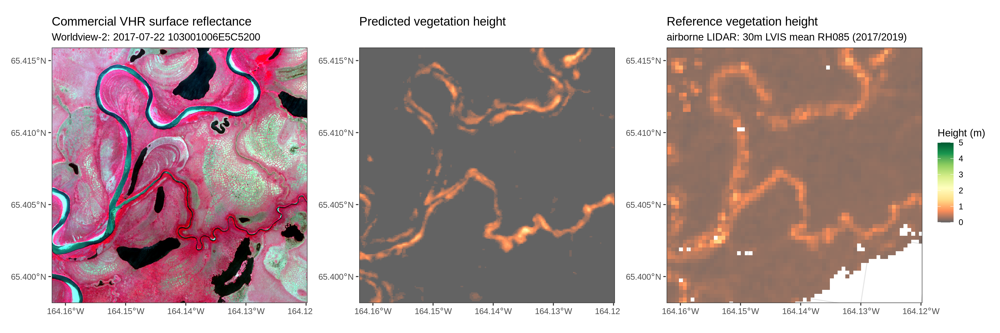

In [17]:
options(repr.plot.width = 15, repr.plot.height = 5, repr.plot.res = 250, warn=-1)

# With LVIS reference
p_show_ref_103001006E5C5200 <- map_raster_by_catid(
  catid = "103001006E5C5200",
  chm_dir = "/explore/nobackup/projects/above/misc/ABoVE_Shrubs/chm/2026_chm/4.3.2.5/dm_10m",
  source_dir = "/explore/nobackup/projects/above/misc/ABoVE_Shrubs/srlite/002m_2023",
  val_csv_dir = "/explore/nobackup/projects/above/misc/ABoVE_Shrubs/validation/chm/dinov3/4.3.2.5/dm_10m/LVISRH075_RH085_RH098",
  lvis_grid_dir = "/explore/nobackup/people/pmontesa/userfs02/data/LVIS/2019/output/metrics/30",
    lvis_rh_str = 'RH085',
  use_forest_ht_cmap = TRUE,
  fill_label = "Height (m)",
  crop_center_lon = -164.1443,
  crop_center_lat = 65.4084,
  crop_width_pixels = 200,
  crop_height_pixels = 200,
                         chm_max_value = 5,
                         edge_buffer = 1.15,  # Crop 15% larger, display smaller
  SHOW_REF = TRUE,
  SCALE_FACTOR = 0.1
)
print(p_show_ref_103001006E5C5200)


=== CHM Processing ===
Searching for catid: 10300100255A5800 in /explore/nobackup/projects/above/misc/ABoVE_Shrubs/chm/2026_chm/4.3.2.5/dm_10m 
Using CHM file: WV02_20130725_M1BS_10300100255A5800-chm-dm-10m.tif 
CHM CRS: NAD83 / Alaska Albers 
CHM dimensions: 12091 2444 
Applying crop with buffer: 500 x 500 pixels
Display extent: 114868.3 119868.3 1904553 1909553 
Crop extent (with buffer): 114493.3 120243.3 1904178 1909928 
Cropped CHM dimensions: 575 575 
CHM extent: 114495, 120245, 1904175, 1909925 

=== Source Processing ===
Searching for catid: 10300100255A5800 in /explore/nobackup/projects/above/misc/ABoVE_Shrubs/srlite/002m_2023 
Using source file: WV02_20130725_M1BS_10300100255A5800-sr-02m.tif 
Loading source raster...
Source CRS: WGS 84 / UTM zone 5N 
Source dimensions: 60654 11353 
Source bands: 8 
Source and CHM in same CRS: FALSE 
Cropping source to buffered CHM extent...
CHM extent in source CRS: 570444.1 576237.9 7440581 7446436 
Reprojecting cropped source to CHM CRS...

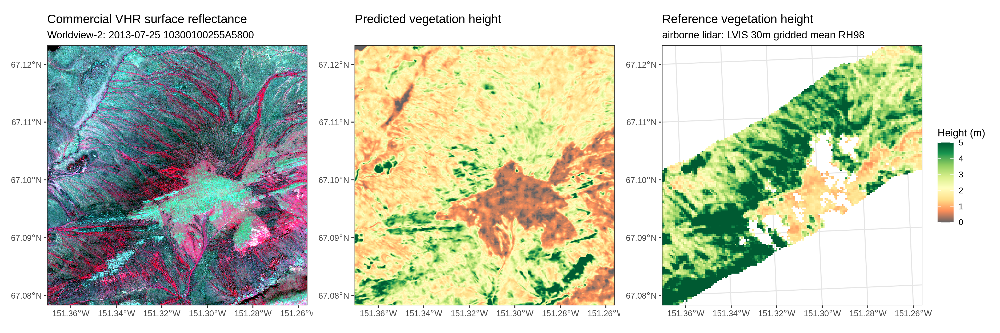

In [21]:
options(repr.plot.width = 15, repr.plot.height = 5, repr.plot.res = 250, warn=-1)

# Usage examples:

# With LVIS reference
p_show_ref_10300100255A5800 <- map_raster_by_catid(
    catid = "10300100255A5800",
    chm_dir = "/explore/nobackup/projects/above/misc/ABoVE_Shrubs/chm/2026_chm/4.3.2.5/dm_10m",
    source_dir = "/explore/nobackup/projects/above/misc/ABoVE_Shrubs/srlite/002m_2023",
    val_csv_dir = "/explore/nobackup/projects/above/misc/ABoVE_Shrubs/validation/chm/dinov3/4.3.2.5/dm_10m/LVISRH075_RH085_RH098",
    lvis_grid_dir = "/explore/nobackup/people/pmontesa/userfs02/data/LVIS/2019/output/metrics/30",
    use_forest_ht_cmap = TRUE,
    fill_label = "Height (m)",
    crop_center_lon = -151.31089,
    crop_center_lat = 67.09989,
    crop_width_pixels = 500,
    crop_height_pixels = 500,
                         chm_max_value = 5,
                         edge_buffer = 1.15,  # Crop 15% larger, display smaller
  SHOW_REF = TRUE,
  SCALE_FACTOR = 0.1
)
print(p_show_ref_10300100255A5800)


=== CHM Processing ===
Searching for catid: 10300100255A5800 in /explore/nobackup/projects/above/misc/ABoVE_Shrubs/chm/2026_chm/4.3.2.5/dm_10m 
Using CHM file: WV02_20130725_M1BS_10300100255A5800-chm-dm-10m.tif 
CHM CRS: NAD83 / Alaska Albers 
CHM dimensions: 12091 2444 
Applying crop with buffer: 200 x 200 pixels
Display extent: 116368.3 118368.3 1906053 1908053 
Crop extent (with buffer): 116218.3 118518.3 1905903 1908203 
Cropped CHM dimensions: 230 230 
CHM extent: 116215, 118515, 1905905, 1908205 

=== Source Processing ===
Searching for catid: 10300100255A5800 in /explore/nobackup/projects/above/misc/ABoVE_Shrubs/srlite/002m_2023 
Using source file: WV02_20130725_M1BS_10300100255A5800-sr-02m.tif 
Loading source raster...
Source CRS: WGS 84 / UTM zone 5N 
Source dimensions: 60654 11353 
Source bands: 8 
Source and CHM in same CRS: FALSE 
Cropping source to buffered CHM extent...
CHM extent in source CRS: 572177.5 574495 7442343 7444685 
Reprojecting cropped source to CHM CRS...
C

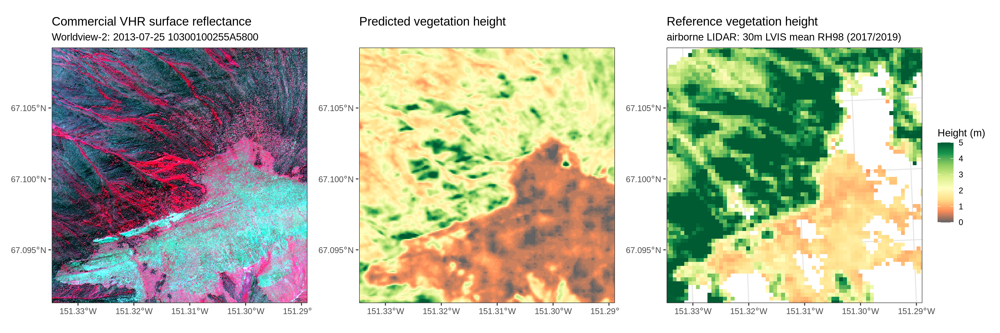

In [130]:
options(repr.plot.width = 15, repr.plot.height = 5, repr.plot.res = 250, warn=-1)

# Usage examples:

# With LVIS reference
p_show_ref_10300100255A5800 <- map_raster_by_catid(
    catid = "10300100255A5800",
    chm_dir = "/explore/nobackup/projects/above/misc/ABoVE_Shrubs/chm/2026_chm/4.3.2.5/dm_10m",
    source_dir = "/explore/nobackup/projects/above/misc/ABoVE_Shrubs/srlite/002m_2023",
    val_csv_dir = "/explore/nobackup/projects/above/misc/ABoVE_Shrubs/validation/chm/dinov3/4.3.2.5/dm_10m/LVISRH075_RH085_RH098",
    lvis_grid_dir = "/explore/nobackup/people/pmontesa/userfs02/data/LVIS/2019/output/metrics/30",
    use_forest_ht_cmap = TRUE,
    fill_label = "Height (m)",
    crop_center_lon = -151.31089,
    crop_center_lat = 67.09989,
    crop_width_pixels = 200,
    crop_height_pixels = 200,
                         chm_max_value = 5,
                         edge_buffer = 1.15,  # Crop 15% larger, display smaller
  SHOW_REF = TRUE,
  SCALE_FACTOR = 0.1
)
print(p_show_ref_10300100255A5800)


=== CHM Processing ===
Searching for catid: 10300100263C5F00 in /explore/nobackup/projects/above/misc/ABoVE_Shrubs/chm/2026_chm/4.3.2.5/dm_10m 
Using CHM file: WV02_20130826_M1BS_10300100263C5F00-chm-dm-10m.tif 
CHM CRS: NAD83 / Alaska Albers 
CHM dimensions: 11771 2098 
Applying crop with buffer: 200 x 200 pixels
Display extent: 34062.71 36062.71 1860033 1862033 
Crop extent (with buffer): 33912.71 36212.71 1859883 1862183 
Cropped CHM dimensions: 230 230 
CHM extent: 33915, 36215, 1859885, 1862185 

=== Source Processing ===
Searching for catid: 10300100263C5F00 in /explore/nobackup/projects/above/misc/ABoVE_Shrubs/srlite/002m_2023 
Using source file: WV02_20130826_M1BS_10300100263C5F00-sr-02m.tif 
Loading source raster...
Source CRS: WGS 84 / UTM zone 5N 
Source dimensions: 58881 9555 
Source bands: 8 
Source and CHM in same CRS: FALSE 
Cropping source to buffered CHM extent...
CHM extent in source CRS: 489624.5 491949.5 7397334 7399676 
Reprojecting cropped source to CHM CRS...
Cr

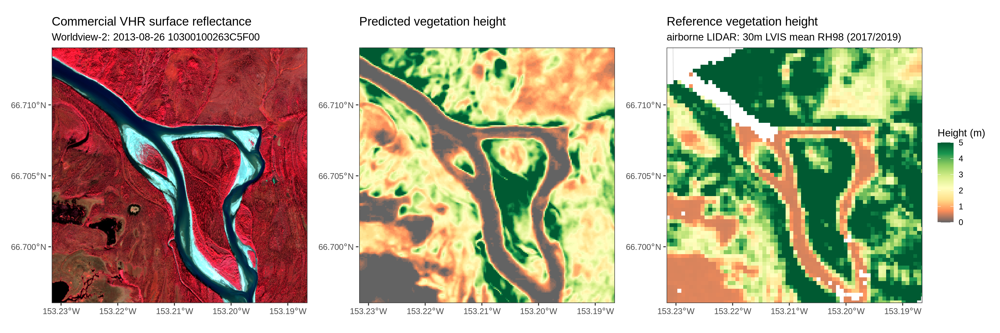

In [131]:
options(repr.plot.width = 15, repr.plot.height = 5, repr.plot.res = 250, warn=-1)

# Usage examples:

# With LVIS reference
p_show_ref_10300100263C5F00 <- map_raster_by_catid(
    catid = "10300100263C5F00",
    chm_dir = "/explore/nobackup/projects/above/misc/ABoVE_Shrubs/chm/2026_chm/4.3.2.5/dm_10m",
    source_dir = "/explore/nobackup/projects/above/misc/ABoVE_Shrubs/srlite/002m_2023",
    val_csv_dir = "/explore/nobackup/projects/above/misc/ABoVE_Shrubs/validation/chm/dinov3/4.3.2.5/dm_10m/LVISRH075_RH085_RH098",
    lvis_grid_dir = "/explore/nobackup/people/pmontesa/userfs02/data/LVIS/2019/output/metrics/30",
    use_forest_ht_cmap = TRUE,
    fill_label = "Height (m)",
    crop_center_lon = -153.20882,
    crop_center_lat = 66.70493,
    crop_width_pixels = 200,
    crop_height_pixels = 200,
                         chm_max_value = 5,
                         edge_buffer = 1.15,  # Crop 15% larger, display smaller
  SHOW_REF = TRUE,
  SCALE_FACTOR = 0.1
)
print(p_show_ref_10300100263C5F00)


=== CHM Processing ===
Searching for catid: 103001002686A600 in /explore/nobackup/projects/above/misc/ABoVE_Shrubs/chm/2026_chm/4.3.2.5/dm_10m 
Using CHM file: WV02_20130825_M1BS_103001002686A600-chm-dm-10m.tif 
CHM CRS: NAD83 / Alaska Albers 
CHM dimensions: 11768 3220 
Applying crop with buffer: 500 x 500 pixels
Display extent: -310516 -305516 2016692 2021692 
Crop extent (with buffer): -310891 -305141 2016317 2022067 
Cropped CHM dimensions: 575 462 
CHM extent: -309765, -305145, 2016315, 2022065 

=== Source Processing ===
Searching for catid: 103001002686A600 in /explore/nobackup/projects/above/misc/ABoVE_Shrubs/srlite/002m_2023 
Using source file: WV02_20130825_M1BS_103001002686A600-sr-02m.tif 
Loading source raster...
Source CRS: WGS 84 / UTM zone 4N 
Source dimensions: 58666 11819 
Source bands: 8 
Source and CHM in same CRS: FALSE 
Cropping source to buffered CHM extent...
CHM extent in source CRS: 401195.5 406177 7539430 7545549 
Reprojecting cropped source to CHM CRS...
Cro

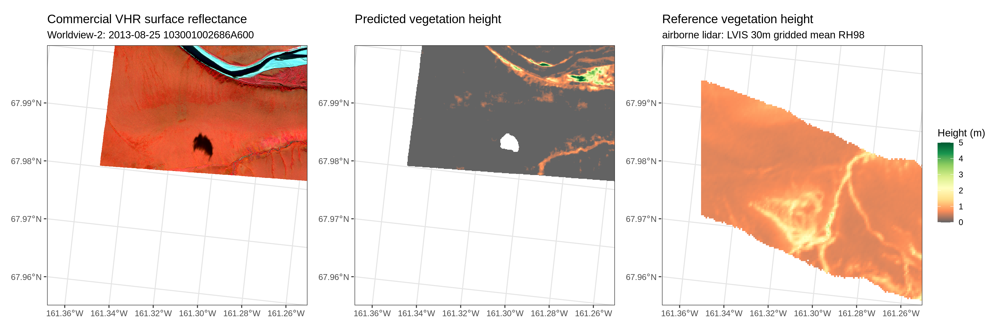

In [18]:
options(repr.plot.width = 15, repr.plot.height = 5, repr.plot.res = 250, warn=-1)

# Usage examples:

# With LVIS reference
p_show_ref_103001002686A600 <- map_raster_by_catid(
    catid = "103001002686A600",
    chm_dir = "/explore/nobackup/projects/above/misc/ABoVE_Shrubs/chm/2026_chm/4.3.2.5/dm_10m",
    source_dir = "/explore/nobackup/projects/above/misc/ABoVE_Shrubs/srlite/002m_2023",
    val_csv_dir = "/explore/nobackup/projects/above/misc/ABoVE_Shrubs/validation/chm/dinov3/4.3.2.5/dm_10m/LVISRH075_RH085_RH098",
    lvis_grid_dir = "/explore/nobackup/people/pmontesa/userfs02/data/LVIS/2019/output/metrics/30",
    use_forest_ht_cmap = TRUE,
    fill_label = "Height (m)",
    crop_center_lon = -161.31563,
    crop_center_lat = 67.98,
    crop_width_pixels = 500,
    crop_height_pixels = 500,
                         chm_max_value = 5,
                         edge_buffer = 1.15,  # Crop 15% larger, display smaller
  SHOW_REF = TRUE,
  SCALE_FACTOR = 0.1
)
print(p_show_ref_103001002686A600)


=== CHM Processing ===
Searching for catid: 10300100066AFE00 in /explore/nobackup/projects/above/misc/ABoVE_Shrubs/chm/2026_chm/4.3.2.5/dm_10m 
Using CHM file: WV02_20100824_M1BS_10300100066AFE00-chm-dm-10m.tif 
CHM CRS: NAD83 / Alaska Albers 
CHM dimensions: 10028 2853 
Applying crop with buffer: 500 x 500 pixels
Display extent: -181913.1 -176913.1 1794178 1799178 
Crop extent (with buffer): -182288.1 -176538.1 1793803 1799553 
Cropped CHM dimensions: 575 575 
CHM extent: -182285, -176535, 1793805, 1799555 

=== Source Processing ===
Searching for catid: 10300100066AFE00 in /explore/nobackup/projects/above/misc/ABoVE_Shrubs/srlite/002m_2023 
Using source file: WV02_20100824_M1BS_10300100066AFE00-sr-02m.tif 
Loading source raster...
Source CRS: WGS 84 / UTM zone 4N 
Source dimensions: 49604 10477 
Source bands: 8 
Source and CHM in same CRS: FALSE 
Cropping source to buffered CHM extent...
CHM extent in source CRS: 544101.6 550257 7326115 7332298 
Reprojecting cropped source to CHM CR

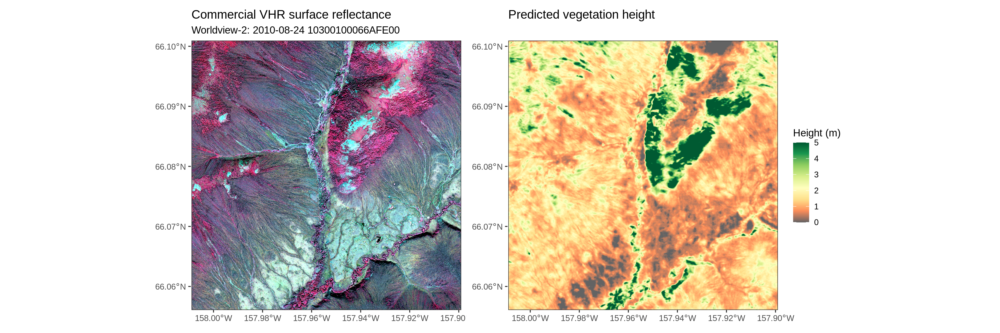

In [16]:
options(repr.plot.width = 15, repr.plot.height = 5, repr.plot.res = 250, warn=-1)

# Usage examples:

# With LVIS reference
p_show_ref_10300100066AFE00 <- map_raster_by_catid(
    catid = "10300100066AFE00",
    chm_dir = "/explore/nobackup/projects/above/misc/ABoVE_Shrubs/chm/2026_chm/4.3.2.5/dm_10m",
    source_dir = "/explore/nobackup/projects/above/misc/ABoVE_Shrubs/srlite/002m_2023",
    val_csv_dir = "/explore/nobackup/projects/above/misc/ABoVE_Shrubs/validation/chm/dinov3/4.3.2.5/dm_10m/LVISRH075_RH085_RH098",
    lvis_grid_dir = "/explore/nobackup/people/pmontesa/userfs02/data/LVIS/2019/output/metrics/30",
    use_forest_ht_cmap = TRUE,
    fill_label = "Height (m)",
    crop_center_lon = -157.95727,
    crop_center_lat = 66.07986,
    crop_width_pixels = 500,
    crop_height_pixels = 500,
                         chm_max_value = 5,
                         edge_buffer = 1.15,  # Crop 15% larger, display smaller
  SHOW_REF = TRUE,
  SCALE_FACTOR = 0.1
)
print(p_show_ref_10300100066AFE00)


=== CHM Processing ===
Searching for catid: 10300100066AFE00 in /explore/nobackup/projects/above/misc/ABoVE_Shrubs/chm/2026_chm/4.3.2.5/dm_10m 
Using CHM file: WV02_20100824_M1BS_10300100066AFE00-chm-dm-10m.tif 
CHM CRS: NAD83 / Alaska Albers 
CHM dimensions: 10028 2853 
Applying crop with buffer: 500 x 500 pixels
Display extent: -170565.4 -165565.4 1792068 1797068 
Crop extent (with buffer): -170940.4 -165190.4 1791693 1797443 
Cropped CHM dimensions: 575 575 
CHM extent: -170945, -165195, 1791695, 1797445 

=== Source Processing ===
Searching for catid: 10300100066AFE00 in /explore/nobackup/projects/above/misc/ABoVE_Shrubs/srlite/002m_2023 
Using source file: WV02_20100824_M1BS_10300100066AFE00-sr-02m.tif 
Loading source raster...
Source CRS: WGS 84 / UTM zone 4N 
Source dimensions: 49604 10477 
Source bands: 8 
Source and CHM in same CRS: FALSE 
Cropping source to buffered CHM extent...
CHM extent in source CRS: 555539.1 561696 7324873 7331056 
Reprojecting cropped source to CHM CR

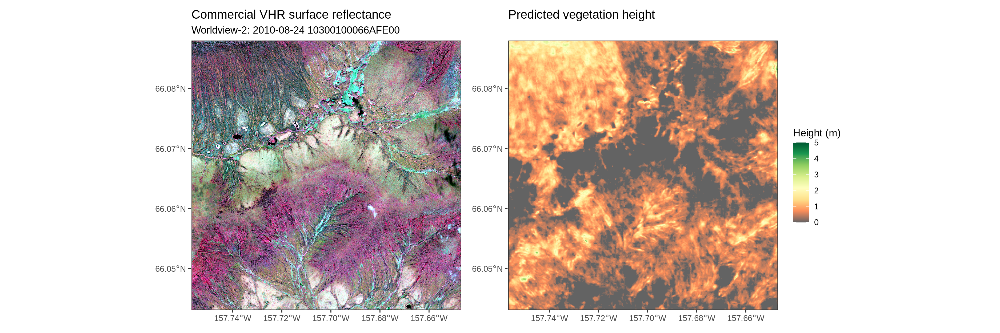

In [15]:
options(repr.plot.width = 15, repr.plot.height = 5, repr.plot.res = 250, warn=-1)

# Usage examples:

# With LVIS reference
p_show_ref_10300100066AFE00 <- map_raster_by_catid(
    catid = "10300100066AFE00",
    chm_dir = "/explore/nobackup/projects/above/misc/ABoVE_Shrubs/chm/2026_chm/4.3.2.5/dm_10m",
    source_dir = "/explore/nobackup/projects/above/misc/ABoVE_Shrubs/srlite/002m_2023",
    val_csv_dir = "/explore/nobackup/projects/above/misc/ABoVE_Shrubs/validation/chm/dinov3/4.3.2.5/dm_10m/LVISRH075_RH085_RH098",
    lvis_grid_dir = "/explore/nobackup/people/pmontesa/userfs02/data/LVIS/2019/output/metrics/30",
    use_forest_ht_cmap = TRUE,
    fill_label = "Height (m)",
    crop_center_lon = -157.70492,
    crop_center_lat = 66.06681,
    crop_width_pixels = 500,
    crop_height_pixels = 500,
                         chm_max_value = 5,
                         edge_buffer = 1.15,  # Crop 15% larger, display smaller
  SHOW_REF = TRUE,
  SCALE_FACTOR = 0.1
)
print(p_show_ref_10300100066AFE00)

Linking to GEOS 3.11.2, GDAL 3.7.0, PROJ 9.2.0; sf_use_s2() is TRUE


Attaching package: ‘patchwork’


The following object is masked from ‘package:terra’:

    area



Attaching package: ‘scales’


The following object is masked from ‘package:terra’:

    rescale





=== CHM Processing ===
Searching for catid: 10300100233EDD00 in /explore/nobackup/projects/above/misc/ABoVE_Shrubs/chm/2026_chm/4.3.2.5/dm_10m 
Using CHM file: WV02_20130611_M1BS_10300100233EDD00-chm-dm-10m.tif 
CHM CRS: NAD83 / Alaska Albers 
CHM dimensions: 11918 3268 
Applying crop with buffer: 500 x 500 pixels
Display extent: -372655.7 -367655.7 1425036 1430036 
Crop extent (with buffer): -373030.7 -367280.7 1424661 1430411 
Cropped CHM dimensions: 575 575 
CHM extent: -373035, -367285, 1424665, 1430415 

=== Source Processing ===
Searching for catid: 10300100233EDD00 in /explore/nobackup/projects/above/misc/ABoVE_Shrubs/srlite/002m_2023 
Using source file: WV02_20130611_M1BS_10300100233EDD00-sr-02m.tif 
Loading source raster...
Source CRS: WGS 84 / UTM zone 4N 
Source dimensions: 58669 12016 
Source bands: 8 
Source and CHM in same CRS: FALSE 
Cropping source to buffered CHM extent...
CHM extent in source CRS: 381469.1 387647.9 6944206 6950346 
Reprojecting cropped source to CHM 

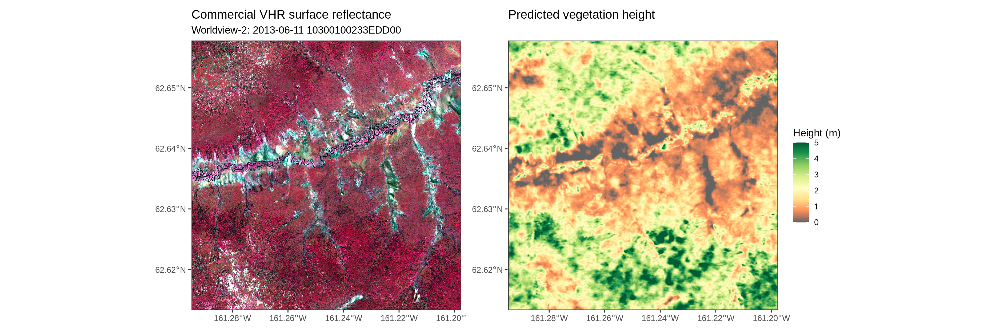

In [10]:
options(repr.plot.width = 15, repr.plot.height = 5, repr.plot.res = 250, warn=-1)

# Usage examples:

# With LVIS reference
p_show_ref_10300100233EDD00 <- map_raster_by_catid(
    catid = "10300100233EDD00",
    chm_dir = "/explore/nobackup/projects/above/misc/ABoVE_Shrubs/chm/2026_chm/4.3.2.5/dm_10m",
    source_dir = "/explore/nobackup/projects/above/misc/ABoVE_Shrubs/srlite/002m_2023",
    val_csv_dir = "/explore/nobackup/projects/above/misc/ABoVE_Shrubs/validation/chm/dinov3/4.3.2.5/dm_10m/LVISRH075_RH085_RH098",
    lvis_grid_dir = "/explore/nobackup/people/pmontesa/userfs02/data/LVIS/2019/output/metrics/30",
    use_forest_ht_cmap = TRUE,
    fill_label = "Height (m)",
    crop_center_lon = -161.2515,
    crop_center_lat = 62.6380,
    crop_width_pixels = 500,
    crop_height_pixels = 500,
                         chm_max_value = 5,
                         edge_buffer = 1.15,  # Crop 15% larger, display smaller
  SHOW_REF = TRUE,
  SCALE_FACTOR = 0.1
)
print(p_show_ref_10300100233EDD00)

#### [NOT USEFUL]

In [ ]:
options(repr.plot.width = 15, repr.plot.height = 5, repr.plot.res = 250, warn=-1)

# Usage examples:

# With LVIS reference
p_show_ref_10300100A70F3B00 <- map_raster_by_catid(
  catid = "10300100A70F3B00",
  chm_dir = "/explore/nobackup/projects/above/misc/ABoVE_Shrubs/chm/2026_chm/4.3.2.5/dm_10m",
  source_dir = "/explore/nobackup/projects/above/misc/ABoVE_Shrubs/srlite/002m_2023",
  val_csv_dir = "/explore/nobackup/projects/above/misc/ABoVE_Shrubs/validation/chm/dinov3/4.3.2.5/dm_10m/LVISRH075_RH085_RH098",
  lvis_grid_dir = "/explore/nobackup/people/pmontesa/userfs02/data/LVIS/2019/output/metrics/30",
  use_forest_ht_cmap = TRUE,
  fill_label = "Height (m)",
  crop_center_lon = -158.1120,
  crop_center_lat = 65.4456,
  crop_width_pixels = 500,
  crop_height_pixels = 500,
                         chm_max_value = 5,
                         edge_buffer = 1.15,  # Crop 15% larger, display smaller
  SHOW_REF = TRUE,
  SCALE_FACTOR = 0.1
)
print(p_show_ref_10300100A70F3B00)

#### Map a bad catid? [NOT NEEDED]

In [ ]:
options(repr.plot.width = 15, repr.plot.height = 5, repr.plot.res = 250, warn=-1)

# Usage examples:

# Custom CHM max = 20
p_bad_103001000C00E300 <- map_raster_by_catid( 
    catid = "103001000C00E300", 
    chm_dir = "/explore/nobackup/projects/above/misc/ABoVE_Shrubs/chm/2026_chm/4.3.2.5/dm_10m",
    source_dir = "/explore/nobackup/projects/above/misc/ABoVE_Shrubs/srlite/002m_2023",
    val_csv_dir = "/explore/nobackup/projects/above/misc/ABoVE_Shrubs/validation/chm/dinov3/4.3.2.5/dm_10m/LVISRH075_RH085_RH098",
    lvis_grid_dir = "/explore/nobackup/people/pmontesa/userfs02/data/LVIS/2019/output/metrics/30",
    use_forest_ht_cmap = TRUE,
    fill_label = "Height (m)",
    crop_center_lon = -148.7,
    crop_center_lat = 63.22,
    crop_width_pixels = 500,
    crop_height_pixels = 500,
                         chm_max_value = 5,
                         edge_buffer = 1.15,  # Crop 15% larger, display smaller
  SHOW_REF = TRUE,
  SCALE_FACTOR = 0.1
)  # Crop 15% larger, display smaller

print(p_bad_103001000C00E300)


=== CHM Processing ===
Searching for catid: 1030010019B16500 in /explore/nobackup/projects/above/misc/ABoVE_Shrubs/chm/2026_chm/4.3.2.5/dm_10m 
Using CHM file: WV02_20120706_M1BS_1030010019B16500-chm-dm-10m.tif 
CHM CRS: NAD83 / Alaska Albers 
CHM dimensions: 7965 3164 
Applying crop with buffer: 500 x 500 pixels
Display extent: -543075.3 -538075.3 1717126 1722126 
Crop extent (with buffer): -543450.3 -537700.3 1716751 1722501 
Cropped CHM dimensions: 575 575 
CHM extent: -543455, -537705, 1716755, 1722505 

=== Source Processing ===
Searching for catid: 1030010019B16500 in /explore/nobackup/projects/above/misc/ABoVE_Shrubs/srlite/002m_2023 
Using source file: WV02_20120706_M1BS_1030010019B16500-sr-02m.tif 
Loading source raster...
Source CRS: WGS 84 / UTM zone 3N 
Source dimensions: 38742 9572 
Source bands: 4 
Source and CHM in same CRS: FALSE 
Cropping source to buffered CHM extent...
CHM extent in source CRS: 472073.9 478688.6 7206810 7213425 
Reprojecting cropped source to CHM CR

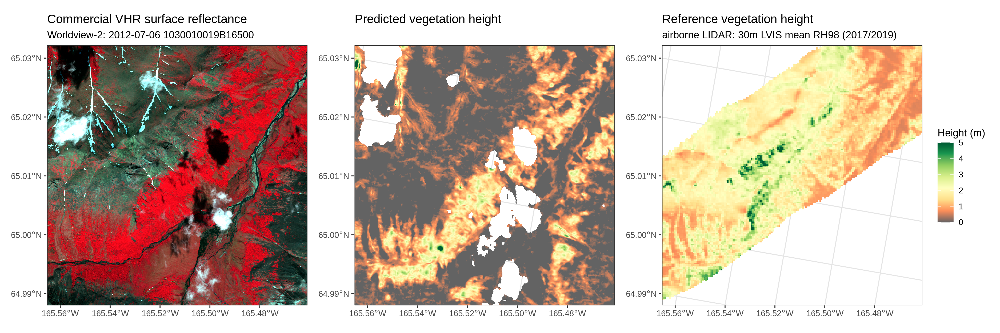

In [23]:
options(repr.plot.width = 15, repr.plot.height = 5, repr.plot.res = 250, warn=-1)

# Usage examples:

# Custom CHM max = 20
p_good_seward_1030010019B16500_1 <- map_raster_by_catid( 
    catid = '1030010019B16500',#'103001009A81F500', # "1030010099BF2F00", 
    chm_dir = "/explore/nobackup/projects/above/misc/ABoVE_Shrubs/chm/2026_chm/4.3.2.5/dm_10m",
    source_dir = "/explore/nobackup/projects/above/misc/ABoVE_Shrubs/srlite/002m_2023",
    val_csv_dir = "/explore/nobackup/projects/above/misc/ABoVE_Shrubs/validation/chm/dinov3/4.3.2.5/dm_10m/LVISRH075_RH085_RH098",
    lvis_grid_dir = "/explore/nobackup/people/pmontesa/userfs02/data/LVIS/2019/output/metrics/30",
    use_forest_ht_cmap = TRUE,
    fill_label = "Height (m)",
    # Not bad point
    # crop_center_lon = -165.49433,
    # crop_center_lat = 65.02621,
    # Better point?
    crop_center_lon = -165.52223,
    crop_center_lat = 65.01398,
    crop_width_pixels = 500,
    crop_height_pixels = 500,
                         chm_max_value = 5,
                         edge_buffer = 1.15,  # Crop 15% larger, display smaller
  SHOW_REF = TRUE,
  SCALE_FACTOR = 0.1
)  # Crop 15% larger, display smaller

print(p_good_seward_1030010019B16500_1)


=== CHM Processing ===
Searching for catid: 1030010019B16500 in /explore/nobackup/projects/above/misc/ABoVE_Shrubs/chm/2026_chm/4.3.2.5/dm_10m 
Using CHM file: WV02_20120706_M1BS_1030010019B16500-chm-dm-10m.tif 
CHM CRS: NAD83 / Alaska Albers 
CHM dimensions: 7965 3164 
Applying crop with buffer: 500 x 500 pixels
Display extent: -554365.2 -549365.2 1699652 1704652 
Crop extent (with buffer): -554740.2 -548990.2 1699277 1705027 
Cropped CHM dimensions: 575 575 
CHM extent: -554745, -548995, 1699275, 1705025 

=== Source Processing ===
Searching for catid: 1030010019B16500 in /explore/nobackup/projects/above/misc/ABoVE_Shrubs/srlite/002m_2023 
Using source file: WV02_20120706_M1BS_1030010019B16500-sr-02m.tif 
Loading source raster...
Source CRS: WGS 84 / UTM zone 3N 
Source dimensions: 38742 9572 
Source bands: 4 
Source and CHM in same CRS: FALSE 
Cropping source to buffered CHM extent...
CHM extent in source CRS: 463813.2 470429.5 7187723 7194336 
Reprojecting cropped source to CHM CR

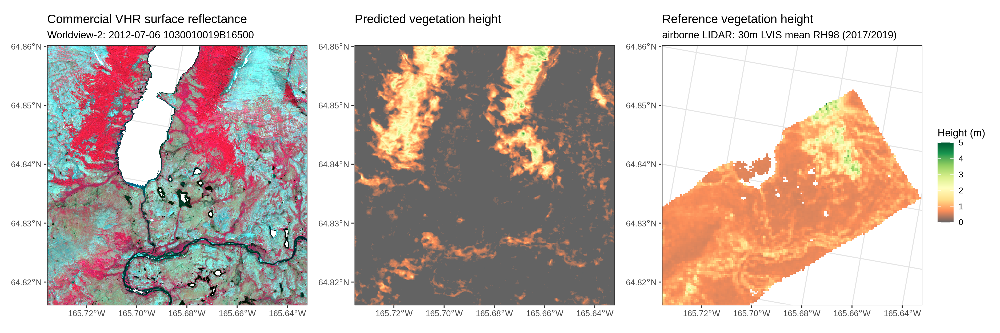

In [20]:
options(repr.plot.width = 15, repr.plot.height = 5, repr.plot.res = 250, warn=-1)

# Usage examples:

# Custom CHM max = 20
p_good_seward_1030010019B16500 <- map_raster_by_catid( 
    catid = '1030010019B16500',#'103001009A81F500', # "1030010099BF2F00", 
    chm_dir = "/explore/nobackup/projects/above/misc/ABoVE_Shrubs/chm/2026_chm/4.3.2.5/dm_10m",
    source_dir = "/explore/nobackup/projects/above/misc/ABoVE_Shrubs/srlite/002m_2023",
    val_csv_dir = "/explore/nobackup/projects/above/misc/ABoVE_Shrubs/validation/chm/dinov3/4.3.2.5/dm_10m/LVISRH075_RH085_RH098",
    lvis_grid_dir = "/explore/nobackup/people/pmontesa/userfs02/data/LVIS/2019/output/metrics/30",
    use_forest_ht_cmap = TRUE,
    fill_label = "Height (m)",
    crop_center_lon = -165.69305,
    crop_center_lat = 64.84205,
    crop_width_pixels = 500,
    crop_height_pixels = 500,
                         chm_max_value = 5,
                         edge_buffer = 1.15,  # Crop 15% larger, display smaller
  SHOW_REF = TRUE,
  SCALE_FACTOR = 0.1
)  # Crop 15% larger, display smaller

print(p_good_seward_1030010019B16500)

#### Map a good catid - example of Seward site


=== CHM Processing ===
Searching for catid: 10300100968FB300 in /explore/nobackup/projects/above/misc/ABoVE_Shrubs/chm/2026_chm/4.3.2.5/dm_10m 
Using CHM file: WV02_20190820_M1BS_10300100968FB300-chm-dm-10m.tif 
CHM CRS: NAD83 / Alaska Albers 
CHM dimensions: 7480 3088 
Applying crop with buffer: 500 x 500 pixels
Display extent: -514319.8 -509319.8 1703637 1708637 
Crop extent (with buffer): -514694.8 -508944.8 1703262 1709012 
Cropped CHM dimensions: 575 575 
CHM extent: -514695, -508945, 1703265, 1709015 

=== Source Processing ===
Searching for catid: 10300100968FB300 in /explore/nobackup/projects/above/misc/ABoVE_Shrubs/srlite/002m_2023 
Using source file: WV02_20190820_M1BS_10300100968FB300-sr-02m.tif 
Loading source raster...
Source CRS: WGS 84 / UTM zone 3N 
Source dimensions: 36281 9583 
Source bands: 8 
Source and CHM in same CRS: FALSE 
Cropping source to buffered CHM extent...
CHM extent in source CRS: 502650.7 509268.6 7198245 7204862 
Reprojecting cropped source to CHM CR

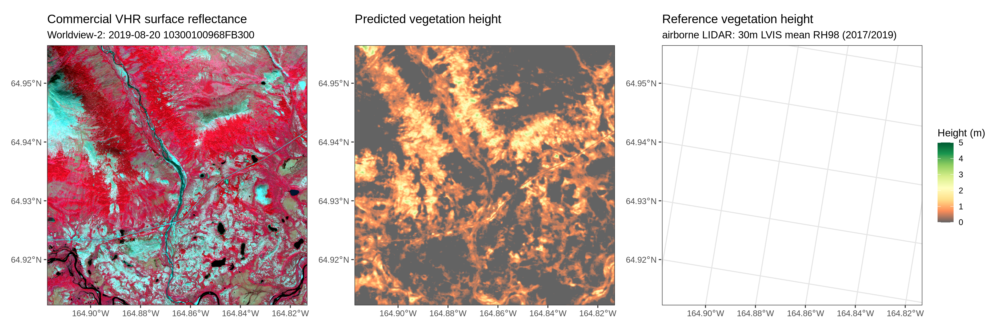

In [24]:
options(repr.plot.width = 15, repr.plot.height = 5, repr.plot.res = 250, warn=-1)

# Usage examples:

# Custom CHM max = 20
p_good_seward_10300100968FB300 <- map_raster_by_catid( 
    catid = "10300100968FB300", 
    chm_dir = "/explore/nobackup/projects/above/misc/ABoVE_Shrubs/chm/2026_chm/4.3.2.5/dm_10m",
    source_dir = "/explore/nobackup/projects/above/misc/ABoVE_Shrubs/srlite/002m_2023",
    val_csv_dir = "/explore/nobackup/projects/above/misc/ABoVE_Shrubs/validation/chm/dinov3/4.3.2.5/dm_10m/LVISRH075_RH085_RH098",
    lvis_grid_dir = "/explore/nobackup/people/pmontesa/userfs02/data/LVIS/2019/output/metrics/30",
    use_forest_ht_cmap = TRUE,
    fill_label = "Height (m)",
    crop_center_lon = -164.8739,
    crop_center_lat = 64.938,
    crop_width_pixels = 500,
    crop_height_pixels = 500,
                         chm_max_value = 5,
                         edge_buffer = 1.15,  # Crop 15% larger, display smaller
  SHOW_REF = TRUE,
  SCALE_FACTOR = 0.1
)  # Crop 15% larger, display smaller

print(p_good_seward_10300100968FB300)

#### Map a good catid - example of good cloud/shadow masking [NOT NEEDED]

In [ ]:
options(repr.plot.width = 15, repr.plot.height = 5, repr.plot.res = 250, warn=-1)

# Usage examples:

# Custom CHM max = 20
p_good_clouds_103001002401CD00 <- map_raster_by_catid( 
    catid = "103001002401CD00", 
    chm_dir = "/explore/nobackup/projects/above/misc/ABoVE_Shrubs/chm/2026_chm/4.3.2.5/dm_10m",
    source_dir = "/explore/nobackup/projects/above/misc/ABoVE_Shrubs/srlite/002m_2023",
    val_csv_dir = "/explore/nobackup/projects/above/misc/ABoVE_Shrubs/validation/chm/dinov3/4.3.2.5/dm_10m/LVISRH075_RH085_RH098",
    lvis_grid_dir = "/explore/nobackup/people/pmontesa/userfs02/data/LVIS/2019/output/metrics/30",
    use_forest_ht_cmap = TRUE,
    fill_label = "Height (m)",
    crop_center_lon = -154.2,
    crop_center_lat = 60.9,
    crop_width_pixels = 500,
    crop_height_pixels = 500,
                         chm_max_value = 5,
                         edge_buffer = 1.15,  # Crop 15% larger, display smaller
  SHOW_REF = TRUE,
  SCALE_FACTOR = 0.1
)  # Crop 15% larger, display smaller

print(p_good_clouds_103001002401CD00)

In [116]:
options(repr.plot.width = 15, repr.plot.height = 25, repr.plot.res = 250, warn=-1)

#p_bad_103001000C00E300 / p_good_seward_10300100968FB300 / p_good_clouds_103001002401CD00

p_combined_figure_01 = p_good_seward_1030010019B16500_1 / p_good_seward_1030010019B16500 / p_good_seward_10300100968FB300 / p_show_ref_104001004F54B700 / 
    p_show_ref_103001006E5C5200 / p_show_ref_10300100255A5800 / p_show_ref_10300100263C5F00

p_combined_figure_01

ERROR: Error in eval(expr, envir, enclos): object 'p_show_ref_103001006E5C5200' not found


## Validation stats tables and scatter plots

In [10]:
validation_smry_stats <- function(g, ref_var, src_var, SCALE_FACTOR = 1) {
  
  n <- nrow(g)
  
  # Apply scale factor if provided
  if (is.null(SCALE_FACTOR)) {
    src_values <- g[[src_var]]
  } else {
    src_values <- g[[src_var]] * SCALE_FACTOR
  }
  
  ref_values <- g[[ref_var]]
  
  # Calculate best fit line (linear regression)
  lm_fit <- lm(src_values ~ ref_values)
  lm_summary <- summary(lm_fit)
  
  slope <- coef(lm_fit)[2]
  intercept <- coef(lm_fit)[1]
  r_value <- sqrt(lm_summary$r.squared)  # Pearson correlation coefficient
  p_value <- coef(lm_summary)[2, 4]  # p-value for slope
  std_err <- coef(lm_summary)[2, 2]  # standard error for slope
  
  # Use unscaled values for metrics (like Python version)
  src_actual <- g[[src_var]]
  
  # Regression metrics
  residuals <- ref_values - src_actual
  
  explained_variance <- 1 - var(residuals) / var(ref_values)
  mean_absolute_error <- mean(abs(residuals))
  mse <- mean(residuals^2)
  rmse <- sqrt(mse)
  median_absolute_error <- median(abs(residuals))
  r2score <- cor(ref_values, src_actual)^2
  
  # Return as data frame (tibble)
  tibble(
    n = n,
    slope = slope,
    intercept = intercept,
    r_value = r_value,
    p_value = p_value,
    std_err = std_err,
    ref_var = ref_var,
    r2score = r2score,
    expvarscore = explained_variance,
    mae = mean_absolute_error,
    mse = mse,
    rmse = rmse,
    medae = median_absolute_error
  )
}

In [11]:
plot_scatter_melt_3 <- function(df_val, 
                                sample_frac = 1.0,
                                LIST_REF_VARS,  # e.g., c("ht_m_ref_RH080", "ht_m_ref_RH085", "ht_m_ref_RH090")
                                FACET_VAR_LIST = c('slope_class', 'model_use_class'), 
                                use_facet_wrap = FALSE,  # NEW: Use facet_wrap instead of facet_grid
                                facet_ncol = NULL,       # NEW: Number of columns for facet_wrap
                                SCALE_FACTOR = NULL,
                                dir_val_csv = NULL,
                                dir_val_plots = NULL,
                                BASE_TEXT_SIZE = 12,
                                LABEL_SIZE = 3) {
  
    cat("\n=== Starting plot_scatter_melt_3 ===\n")
    cat("Input columns:", paste(names(df_val), collapse = ", "), "\n")
    cat("Requested metrics:", paste(LIST_REF_VARS, collapse = ", "), "\n")
    cat("Facet variables:", paste(FACET_VAR_LIST, collapse = ", "), "\n")
    cat("Use facet_wrap:", use_facet_wrap, "\n\n")
    
    # Verify requested columns exist
    missing_cols <- setdiff(LIST_REF_VARS, names(df_val))
    if (length(missing_cols) > 0) {
        stop("Error: Requested columns not found in data: ", paste(missing_cols, collapse = ", "))
    }
    
    # === STEP 1: Count summaries BEFORE melting ===
    
    # Count VHR acquisitions per group
    df_smry_N_VHR_GROUP <- df_val %>%
        group_by(across(all_of(c('footprint_name', FACET_VAR_LIST)))) %>%
        summarise(n_obs_footprint = n(), .groups = 'drop') %>%
        group_by(across(all_of(FACET_VAR_LIST))) %>%
        summarise(n_VHR = n(), .groups = 'drop') %>%
        mutate(n_VHR_str = paste0("# VHR acq: ", n_VHR))
    
    N_VHR <- sum(df_smry_N_VHR_GROUP$n_VHR)
    
    # Count observations per group
    df_smry_N_GROUPS <- df_val %>%
        group_by(across(all_of(FACET_VAR_LIST))) %>%
        summarise(n_obs_group = n(), .groups = 'drop') %>%
        mutate(n_obs_group_str = paste0("# obs: ", format(n_obs_group, big.mark = ",")))
    
    N_GROUPS <- nrow(df_smry_N_GROUPS)
    if (N_GROUPS == 3) N_GROUPS <- 4  # For faceting nicely
    
    cat("Number of groups:", N_GROUPS, "\n")
    cat("Total VHR acquisitions:", N_VHR, "\n\n")
    
    # === STEP 2: Select and melt data ===
    
    # Select only needed columns
    cols_to_keep <- c(FACET_VAR_LIST, 'ht_m_src', LIST_REF_VARS)
    df_val_subset <- df_val %>% select(all_of(cols_to_keep))
    
    cat("Columns before melt:", paste(names(df_val_subset), collapse = ", "), "\n")
    
    # Melt: convert reference columns to long format
    df_val_m <- df_val_subset %>%
        pivot_longer(
            cols = all_of(LIST_REF_VARS),
            names_to = "metric",
            values_to = "ref_value"
        )
    
    # Create cleaner metric names for display (e.g., "ht_m_ref_RH080" -> "RH080")
    df_val_m <- df_val_m %>%
        mutate(metric_clean = str_extract(metric, "RH\\d+"))
    
    cat("After melt - unique metrics:", paste(unique(df_val_m$metric_clean), collapse = ", "), "\n")
    cat("Rows in melted data:", nrow(df_val_m), "\n\n")
    
    # Apply scale factor if provided
    if (!is.null(SCALE_FACTOR)) {
        df_val_m <- df_val_m %>%
            mutate(ht_m_src = ht_m_src * SCALE_FACTOR)
        cat("Applied scale factor:", SCALE_FACTOR, "\n")
    }
    
    # === STEP 3: Calculate validation statistics ===
    
    cat("Calculating validation statistics...\n")
    
    df_validation_smry_stats <- df_val_m %>%
        group_by(across(all_of(c(FACET_VAR_LIST, 'metric_clean')))) %>%
        summarise(
            validation_smry_stats(cur_data(), 'ref_value', 'ht_m_src'),
            .groups = 'drop'
        ) %>%
        mutate(across(where(is.numeric), ~round(., 2)))
    
    # Create display strings
    df_validation_smry_stats <- df_validation_smry_stats %>%
        mutate(
            r2_value = round(r_value * r_value, 2),
            r2_value_str = paste0("r² = ", sprintf("%.2f", r2_value)),
            rmse_str = paste0("RMSE = ", sprintf("%.2f", rmse), " m"),
            mae_str = paste0("MAE = ", sprintf("%.2f", mae), " m"),
            bias_str = paste0("bias = ", sprintf("%.2f", intercept), " m")
        )
    
    print(head(df_validation_smry_stats))
    
    # === STEP 4: Sample data for plotting ===
    
    if (sample_frac < 1) {
        cat("Sampling", sample_frac * 100, "% of data for plotting\n")
        df_val_m_plot <- df_val_m %>% slice_sample(prop = sample_frac)
    } else {
        df_val_m_plot <- df_val_m
    }
    
    cat("Plotting", nrow(df_val_m_plot), "observations\n\n")
    
    # === STEP 5: Create plot ===
    
    max_val <- 30
    
    p <- ggplot(df_val_m_plot, aes(x = ref_value, y = ht_m_src)) +
        geom_bin2d(binwidth = 0.25) +
        geom_abline(intercept = 0, slope = 1, linetype = 'dashed', color = 'black', linewidth = 0.5) +
        
        # Left column - validation metrics
        geom_label(data = df_validation_smry_stats, 
                   aes(x = 0, y = max_val - 0, label = r2_value_str), 
                   hjust = 0, vjust = 1, size = LABEL_SIZE, alpha = 0.8) +
        geom_label(data = df_validation_smry_stats, 
                   aes(x = 0, y = max_val - 4, label = rmse_str), 
                   hjust = 0, vjust = 1, size = LABEL_SIZE, alpha = 0.8) +
        geom_label(data = df_validation_smry_stats, 
                   aes(x = 0, y = max_val - 8, label = mae_str), 
                   hjust = 0, vjust = 1, size = LABEL_SIZE, alpha = 0.8) +
        geom_label(data = df_validation_smry_stats, 
                   aes(x = 0, y = max_val - 12, label = bias_str), 
                   hjust = 0, vjust = 1, size = LABEL_SIZE, alpha = 0.8) +
        
        # Right column - sample counts
        geom_label(data = df_smry_N_GROUPS, 
                   aes(x = 15, y = max_val - 0, label = n_obs_group_str), 
                   hjust = 0, vjust = 1, size = LABEL_SIZE, alpha = 0.8) +
        geom_label(data = df_smry_N_VHR_GROUP, 
                   aes(x = 15, y = max_val - 4, label = n_VHR_str), 
                   hjust = 0, vjust = 1, size = LABEL_SIZE, alpha = 0.8) +
        
        coord_cartesian(ylim = c(0, max_val), xlim = c(-2, max_val)) +
        scale_fill_viridis_c(trans = "log10", name = "# obs.", option = "plasma") +
        labs(
            title = '', 
            x = "Reference Canopy Height [m]", 
            y = 'Predicted Canopy Height [m]'
        )
    
    # === STEP 6: Add faceting ===
    
    n_metrics <- length(LIST_REF_VARS)
    
    if (use_facet_wrap) {
        # Use facet_wrap - wraps panels in specified number of columns
        
        if (n_metrics == 1) {
            # Single metric: wrap by facet variables only
            if (length(FACET_VAR_LIST) > 0) {
                facet_vars <- paste(FACET_VAR_LIST, collapse = " + ")
                facet_formula <- as.formula(paste("~", facet_vars))
                cat("Facet wrap formula (single metric):", deparse(facet_formula), "\n")
                p <- p + facet_wrap(facet_formula, ncol = facet_ncol)
            }
        } else {
            # Multiple metrics: include metric_clean in faceting
            if (length(FACET_VAR_LIST) > 0) {
                facet_vars <- paste(c('metric_clean', FACET_VAR_LIST), collapse = " + ")
            } else {
                facet_vars <- "metric_clean"
            }
            facet_formula <- as.formula(paste("~", facet_vars))
            cat("Facet wrap formula (multiple metrics):", deparse(facet_formula), "\n")
            p <- p + facet_wrap(facet_formula, ncol = facet_ncol)
        }
        
        # Adjust plot dimensions for wrap
        if (is.null(facet_ncol)) {
            # Auto-calculate reasonable ncol
            total_facets <- N_GROUPS * n_metrics
            facet_ncol_auto <- ceiling(sqrt(total_facets))
            plot_width <- max(10, 2.5 * facet_ncol_auto)
            plot_height <- max(8, 2.5 * ceiling(total_facets / facet_ncol_auto))
        } else {
            plot_width <- max(10, 2.5 * facet_ncol)
            total_facets <- N_GROUPS * n_metrics
            plot_height <- max(8, 2.5 * ceiling(total_facets / facet_ncol))
        }
        
    } else {
        # Use facet_grid (original behavior)
        
        if (n_metrics == 1) {
            # Single metric: facet by variables only (no metric rows)
            if (length(FACET_VAR_LIST) >= 2) {
                facet_formula <- as.formula(paste(". ~", 
                                                  paste(FACET_VAR_LIST, collapse = " + ")))
            } else if (length(FACET_VAR_LIST) == 1) {
                facet_formula <- as.formula(paste(". ~", FACET_VAR_LIST[1]))
            } else {
                facet_formula <- NULL
            }
        } else {
            # Multiple metrics: metric_clean in rows
            if (length(FACET_VAR_LIST) >= 2) {
                facet_formula <- as.formula(paste("metric_clean ~", 
                                                  paste(FACET_VAR_LIST, collapse = " + ")))
            } else if (length(FACET_VAR_LIST) == 1) {
                facet_formula <- as.formula(paste("metric_clean ~", FACET_VAR_LIST[1]))
            } else {
                facet_formula <- as.formula("metric_clean ~ .")
            }
        }
        
        if (!is.null(facet_formula)) {
            cat("Facet grid formula:", deparse(facet_formula), "\n")
            p <- p + facet_grid(facet_formula)
        }
        
        # Original plot dimensions for grid
        plot_width <- max(10, 2 * N_GROUPS)
        plot_height <- max(4, 2 * n_metrics)
    }
    
    # === STEP 7: Apply theme ===
    
    p <- p + 
        theme_bw(base_size = BASE_TEXT_SIZE) +
        theme(
            text = element_text(size = BASE_TEXT_SIZE),
            strip.text = element_text(size = BASE_TEXT_SIZE, face = "bold"),
            axis.title = element_text(size = BASE_TEXT_SIZE),
            axis.text = element_text(size = BASE_TEXT_SIZE * 0.8),
            legend.text = element_text(size = BASE_TEXT_SIZE * 0.9),
            legend.title = element_text(size = BASE_TEXT_SIZE),
            panel.spacing = unit(0.5, "lines")
        )
    
    # Add caption
    if (!is.null(dir_val_csv)) {
        p <- p + labs(caption = basename(dir_val_csv))
    }
    
    # Add sampling annotation
    if (sample_frac < 1) {
        p <- p + 
            annotate("label", x = 10, y = 2.5, 
                     label = paste0(sample_frac * 100, '% sample'), 
                     size = LABEL_SIZE, hjust = 0, vjust = 1, alpha = 0.7)
    }
    
    # === STEP 8: Set display size and show plot ===
    
    cat("\nPlot dimensions:", plot_width, "x", plot_height, "inches\n")
    
    options(repr.plot.width = plot_width, repr.plot.height = plot_height)
    print(p)
    
    # === STEP 9: Save plot ===
    
    if (!is.null(dir_val_plots)) {
        # Create clean metric names for filename
        metric_names <- str_extract(LIST_REF_VARS, "RH\\d+")
        METRICS_STR <- paste(metric_names, collapse = "_")
        FACET_STR <- paste(FACET_VAR_LIST, collapse = "_")
        
        facet_type <- ifelse(use_facet_wrap, "wrap", "grid")
        
        out_plot_fn <- file.path(
            dir_val_plots, 
            sprintf("plot_scatter_%s_%s_nVHR%04d_%s.png", 
                    facet_type, FACET_STR, N_VHR, METRICS_STR)
        )
        
        ggsave(out_plot_fn, plot = p, dpi = 300, units='cm',
               width = plot_width, height = plot_height)
        
        cat('Saved:', out_plot_fn, '\n')
    }
    
    cat("\n=== Completed ===\n\n")
    
    return(list(
        plot = p, 
        stats = df_validation_smry_stats,
        summary_groups = df_smry_N_GROUPS,
        summary_vhr = df_smry_N_VHR_GROUP
    ))
}

### Plot obs by facets - include tcc interval and check smry stats table for insights - ignore plot, which will be a mess


=== Starting plot_scatter_melt_3 ===
Input columns: ht_m_src, ht_m_ref_RH075, ht_m_ref_RH085, ht_m_ref_RH098, tcc_ref, slope_ref, cnt_ref, tcc_class, file, date, type, footprint_name, catid, sensor, year, month, slope_class, srlite_class, model_use_class 
Requested metrics: ht_m_ref_RH075, ht_m_ref_RH085, ht_m_ref_RH098 
Facet variables: tcc_class, model_use_class 
Use facet_wrap: FALSE 

Number of groups: 10 
Total VHR acquisitions: 898 

Columns before melt: tcc_class, model_use_class, ht_m_src, ht_m_ref_RH075, ht_m_ref_RH085, ht_m_ref_RH098 
After melt - unique metrics: RH075, RH085, RH098 
Rows in melted data: 255327219 

Applied scale factor: 1 
Calculating validation statistics...
# A tibble: 6 × 21
  tcc_class model_use_class metric_clean       n slope intercept r_value p_value
  <chr>     <chr>           <chr>          <dbl> <dbl>     <dbl>   <dbl>   <dbl>
1 0-20%     test            RH075         3.53e7  1.52      0.09    0.51       0
2 0-20%     test            RH085        

tcc_class,model_use_class,metric_clean,n,slope,intercept,r_value,p_value,std_err,ref_var,⋯,expvarscore,mae,mse,rmse,medae,r2_value,r2_value_str,rmse_str,mae_str,bias_str
<chr>,<chr>,<chr>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<chr>,⋯,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<chr>,<chr>,<chr>,<chr>
0-20%,test,RH075,35332432,1.52,0.09,0.51,0,0,ref_value,⋯,-5.97,0.42,0.60,0.78,0.16,0.26,r² = 0.26,RMSE = 0.78 m,MAE = 0.42 m,bias = 0.09 m
0-20%,test,RH085,35332432,1.07,-0.09,0.59,0,0,ref_value,⋯,-1.20,0.45,0.47,0.69,0.27,0.35,r² = 0.35,RMSE = 0.69 m,MAE = 0.45 m,bias = -0.09 m
0-20%,test,RH098,35332432,0.47,-0.21,0.67,0,0,ref_value,⋯,0.45,1.07,1.81,1.35,0.75,0.45,r² = 0.45,RMSE = 1.35 m,MAE = 1.07 m,bias = -0.21 m
0-20%,train,RH075,32849613,1.87,0.00,0.57,0,0,ref_value,⋯,-6.93,0.35,0.55,0.74,0.10,0.32,r² = 0.32,RMSE = 0.74 m,MAE = 0.35 m,bias = 0.00 m
0-20%,train,RH085,32849613,1.34,-0.20,0.65,0,0,ref_value,⋯,-1.59,0.40,0.43,0.65,0.23,0.42,r² = 0.42,RMSE = 0.65 m,MAE = 0.40 m,bias = -0.20 m
0-20%,train,RH098,32849613,0.58,-0.31,0.73,0,0,ref_value,⋯,0.52,0.87,1.17,1.08,0.63,0.53,r² = 0.53,RMSE = 1.08 m,MAE = 0.87 m,bias = -0.31 m
21-40%,test,RH075,4727204,0.82,1.04,0.51,0,0,ref_value,⋯,-0.91,1.49,4.06,2.02,1.14,0.26,r² = 0.26,RMSE = 2.02 m,MAE = 1.49 m,bias = 1.04 m
21-40%,test,RH085,4727204,0.62,0.74,0.55,0,0,ref_value,⋯,-0.03,1.58,4.47,2.11,1.23,0.30,r² = 0.30,RMSE = 2.11 m,MAE = 1.58 m,bias = 0.74 m
21-40%,test,RH098,4727204,0.40,0.43,0.55,0,0,ref_value,⋯,0.28,3.72,19.59,4.43,3.29,0.30,r² = 0.30,RMSE = 4.43 m,MAE = 3.72 m,bias = 0.43 m


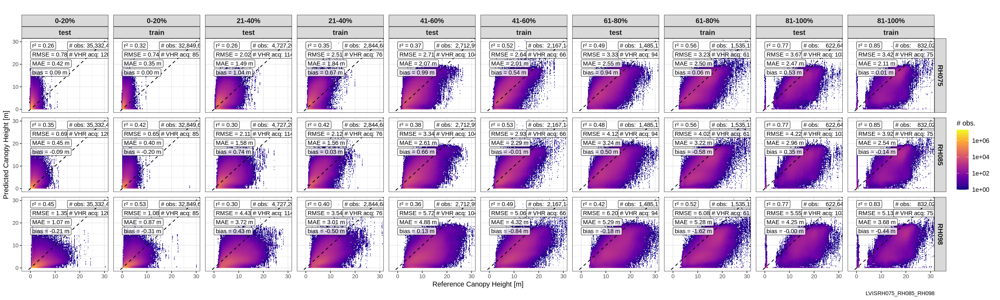

In [12]:
options(repr.plot.width = 10, repr.plot.height = 4, repr.plot.res = 250, warn=-1)

result_tcc_focus <- plot_scatter_melt_3(
    df_val = df_val %>% slice_sample(prop = 1),
    sample_frac = 1,
    LIST_REF_VARS = colnames(df_val %>% select(contains('RH'))),
    FACET_VAR_LIST = c('tcc_class','model_use_class'),
    BASE_TEXT_SIZE = 10,
    LABEL_SIZE = 3.0, 
    SCALE_FACTOR = 1, # Data comes in scaled already
  dir_val_csv = paste0("ABoVE_Shrubs/validation/chm/dinov3/4.3.2.5/dm_10m/",CSV_SET),
  dir_val_plots = OUT_RESULTS_DIR #"/explore/nobackup/projects/above/misc/ABoVE_Shrubs/validation/chm/dinov3/4.3.2.5/dm_10m/plots"
)

stats_tcc_focus <- result_tcc_focus$stats
stats_tcc_focus

In [19]:
ggsave(paste0(OUT_RESULTS_DIR, "/plot_scatter_grid_tcc_class_model_use_class_nVHR0898_RH075_RH085_RH098.png"),
        result_tcc_focus$plot,     
        width = 20, height = 10, dpi = 250, units='cm')

ERROR: Error in plot_theme(plot): object 'result_tcc_focus' not found


In [18]:
write.csv(stats_tcc_focus , paste0(OUT_RESULTS_DIR, "/val_smry_stats_tcc_class_model_use_class.csv"), row.names = FALSE)

ERROR: Error in is.data.frame(x): object 'stats_tcc_focus' not found


# Differences between `r` metrics:

## **1. r_value (Pearson Correlation Coefficient)**
- **Range**: -1 to +1
- **What it measures**: Linear relationship strength and direction
- **Interpretation**: 
  - +1 = perfect positive correlation
  - -1 = perfect negative correlation
  - 0 = no linear relationship
- **Key**: Shows if predicted and reference values move together, but NOT if predictions are accurate

## **2. r2score (R² - Coefficient of Determination)**
- **Range**: 0 to 1 (can be negative for very bad models)
- **Calculation**: `r_value²` or `r2score = 1 - (SS_residual / SS_total)`
- **What it measures**: Proportion of variance in reference data explained by the model
- **Interpretation**: 
  - 1.0 = model explains 100% of variance (perfect fit)
  - 0.5 = model explains 50% of variance
  - 0.0 = model explains nothing (no better than mean)
- **Key**: Most common metric for model goodness-of-fit

## **3. expvarscore (Explained Variance Score)**
- **Range**: 0 to 1 (typically)
- **Calculation**: `1 - Var(y_true - y_pred) / Var(y_true)`
- **What it measures**: Similar to R², but doesn't penalize for systematic bias
- **Interpretation**: Same as R² but ignores constant offset
- **Key difference from R²**: 
  - R² penalizes if your predictions are systematically too high or too low (bias)
  - Explained Variance doesn't care about bias, only about variance explanation

## **Practical Example:**

```
Reference: [10, 20, 30, 40, 50]
Predicted: [12, 22, 32, 42, 52]  (everything +2)

r_value: ~1.0 (perfect correlation)
r2score: ~0.98 (very good, but slightly penalized for bias)
expvarscore: ~1.0 (perfect, doesn't care about the +2 bias)
```

## **Which to use?**

- **r2score**: Most standard, use this for reporting model performance
- **r_value**: Good for understanding correlation strength
- **expvarscore**: Less common, mainly when you care about variance patterns but not bias

**For your case:** I'd recommend keeping only **r2score** since it's the most interpretable and commonly reported. The other two don't add much additional insight!

In [ ]:
library(ggplot2)
library(dplyr)
library(tidyr)
library(RColorBrewer)

# Metrics to plot (excluding 'n' which is only for sizing)
metrics_to_plot <- c('slope', 'intercept' 
                     #, 'r_value'
                     #, 'p_value', 'std_err' 
                     , 'r2score', 'expvarscore'
                     ,'mae'
                     #,'mse'
                     ,'rmse', 'medae')

# Melt the metrics into long format (keep 'n' as a column)
df_long <- stats_tcc_focus %>%
  select(tcc_class, model_use_class, metric_clean, n, all_of(metrics_to_plot)) %>%
  pivot_longer(
    cols = all_of(metrics_to_plot),
    names_to = "metric",
    values_to = "value"
  )

# Check for issues
cat("Data summary:\n")
cat("Total rows:", nrow(df_long), "\n")
cat("NA values:", sum(is.na(df_long$value)), "\n")
cat("Value range:", range(df_long$value, na.rm = TRUE), "\n")
cat("Negative values:", sum(df_long$value < 0, na.rm = TRUE), "\n")

# Create metric groups and ordering
df_long <- df_long %>%
  mutate(
    metric_group = case_when(
      metric %in% c('r2score', 'r_value'
                    , 'expvarscore'
                   ) ~ 'Goodness of Fit',
      metric %in% c('slope', 'intercept','p_value', 'std_err') ~ 'Regression Parameterss',
      metric %in% c('mae', 'rmse', 'mse', 'medae') ~ 'Error Metrics',
      #metric %in% c('p_value', 'std_err') ~ '4. Statistical Tests',
      TRUE ~ 'Other'
    ),
    metric = factor(metric, levels = c(
      'r2score', 'r_value', 
        'expvarscore',
      'slope', 'intercept',
      'mae', 'rmse', 'mse', 'medae',
      'p_value', 'std_err'
    ))
  )

# Define asinh transformation manually
asinh_trans <- function() {
  scales::trans_new(
    name = "asinh",
    transform = asinh,
    inverse = sinh
  )
}




# Create the plot - REMOVED log scale
p <- ggplot(df_long, aes(x = metric_clean, y = value, size = n, fill = tcc_class)) +
  geom_point(alpha = 0.8, shape = 21, color = "black", stroke = 0.3) +
  scale_size_continuous(name = "n", range = c(3, 12)) +
  scale_fill_brewer(palette = "YlGn", name = "TCC Class") +
#scale_y_log10() +
# scale_y_continuous(trans = scales::pseudo_log_trans(sigma = 0.01)) +
# # Then use it
# scale_y_continuous(limits=c(-9,32), trans = asinh_trans()) +
  labs(
    title = "Model Performance Metrics Comparison",
    x = "Reference vegetation relative height metric",
    y = "Metric Value"
  ) +
  theme_bw(base_size = 12) +
  # facet_grid( model_use_class ~ metric, 
  #            scales = "free_y",   # Free y scales
  #            space = "free_y"
  #           ) +
  facet_wrap( model_use_class ~ metric, 
            ncol = length(metrics_to_plot), scales = 'free_y'
            ) +
  theme(
    axis.text.x = element_text(angle = 45, hjust = 1, size = 10),
    axis.text.y = element_text(size = 9),
    strip.text = element_text(face = "bold", size = 9),
    panel.spacing = unit(0.5, "lines")
  )

print(p)

In [ ]:
OUT_RESULTS_DIR

In [ ]:
Sys.Date()

In [ ]:
# Create separate plots for each metric group
plot_list <- list()

for (group_name in sort(unique(df_long$metric_group))) {
  df_group <- df_long %>% filter(metric_group == group_name)
  
  p <- ggplot(df_group, aes(x = metric_clean, y = value, size = n, fill = tcc_class)) +
    geom_point(alpha = 0.8, shape = 21, color = "black", stroke = 0.3) +
    geom_hline(yintercept=0, linetype = 'dotted') +
    #scale_size_continuous(name = "# obs.", range = c(3, 12)) +
    scale_size_continuous(name = "# obs.",, range = c(3, 12)) +
    scale_fill_brewer(palette = "YlGn", name = "Canopy cover", guide = guide_legend(override.aes = list(size = 6))) +
    labs(
      title = group_name,
      x = "Reference vegetation relative height metric",
      y = "Value"
    ) +
    theme_bw(base_size = 12) +
    facet_grid(metric ~ model_use_class, 
               scales = "free_y",
               #space = "free_y"
              ) +
    theme(
      axis.text.x = element_text(angle = 45, hjust = 1, size = 10),
      axis.text.y = element_text(size = 9),
      strip.text = element_text(face = "bold", size = 9),
      panel.spacing = unit(0.5, "lines")
    )
  
  plot_list[[group_name]] <- p
}

# Combine horizontally with SHARED legends
combined_plot <- (plot_list[[1]]+labs(x = "")) + (plot_list[[2]]+labs(x = "Reference vegetation relative height metric")) + (plot_list[[3]]+labs(x = "")) +
  plot_layout(ncol = 3, guides = "collect") &
  theme(legend.position = "bottom")

# Set overall dimensions
options(repr.plot.width = 12, repr.plot.height = 6)

print(combined_plot)

# Save
ggsave(paste0(OUT_RESULTS_DIR, "/validation_metrics_rh_tcc_modeluse_",Sys.Date(),".png"), plot = combined_plot, 
       width = 12, height = 6, dpi = 300)

### Plot obs by facets - main plot

In [ ]:
options(repr.plot.width = 10, repr.plot.height = 4, repr.plot.res = 250, warn=-1)

result_main <- plot_scatter_melt_3(
    df_val = df_val %>% slice_sample(prop = 1),
    sample_frac = 1,
    LIST_REF_VARS = colnames(df_val %>% select(contains('RH'))),
    FACET_VAR_LIST = c('model_use_class'), #c('slope_class', 'srlite_class', 'model_use_class'),
    BASE_TEXT_SIZE = 10,
    LABEL_SIZE = 3.0, 
    SCALE_FACTOR = 1,
  dir_val_csv = paste0("ABoVE_Shrubs/validation/chm/dinov3/4.3.2.5/dm_10m/",CSV_SET),
  dir_val_plots = OUT_RESULTS_DIR
)

# Access results
# plot <- result$plot
stats_main <- result_main$stats
stats_main

In [ ]:
write.csv(stats_main , paste0(OUT_RESULTS_DIR, "/val_smry_stats_main_model_use_class.csv"), row.names = FALSE)

In [ ]:
head(stats_main)

### Plot obs from all catids (10% of data) - helps find bad catids

In [1]:
options(repr.plot.width = 10, repr.plot.height = 4, repr.plot.res = 250, warn=-1)

result_catid <- plot_scatter_melt_3(
    df_val = df_val %>% 
        filter(catid != '103001006D9E2100') %>% # bad catid id - empty?
    slice_sample(prop = 1)
    ,
    sample_frac = 1,
    LIST_REF_VARS = c("ht_m_ref_RH075"),
    #FACET_VAR_LIST = c('tcc_class','slope_class', 'srlite_class', 'model_use_class'),
    FACET_VAR_LIST = c('catid'),
    use_facet_wrap = TRUE,
    facet_ncol = 8,  
    BASE_TEXT_SIZE = 10,
    LABEL_SIZE = 3.5, 
    SCALE_FACTOR = 1,
  dir_val_csv = paste0("ABoVE_Shrubs/validation/chm/dinov3/4.3.2.5/dm_10m/",CSV_SET),
  dir_val_plots = "/explore/nobackup/projects/above/misc/ABoVE_Shrubs/validation/chm/dinov3/4.3.2.5/dm_10m/plots"
)

# Access results
plot_catid <- result_catid$plot
stats_catid <- result_catid$stats

ERROR: Error in plot_scatter_melt_3(df_val = df_val %>% filter(catid != "103001006D9E2100") %>% : could not find function "plot_scatter_melt_3"


#### Using `stats` filter to find bad catids

In [14]:
R2_THRESH_FOR_BAD_CATID = 0.25

In [15]:
bad_preds_catid_list = (stats %>% filter(r2_value < R2_THRESH_FOR_BAD_CATID))$catid

### Plot obs from bad catids (100% of data)


=== Starting plot_scatter_melt_3 ===
Input columns: ht_m_src, ht_m_ref_RH075, ht_m_ref_RH085, ht_m_ref_RH098, tcc_ref, slope_ref, cnt_ref, tcc_class, file, date, type, footprint_name, catid, sensor, year, month, slope_class, srlite_class, model_use_class 
Requested metrics: ht_m_ref_RH075 
Facet variables: catid 
Use facet_wrap: TRUE 

Number of groups: 76 
Total VHR acquisitions: 76 

Columns before melt: catid, ht_m_src, ht_m_ref_RH075 
After melt - unique metrics: RH075 
Rows in melted data: 26878931 

Applied scale factor: 1 
Calculating validation statistics...
# A tibble: 6 × 20
  catid      metric_clean      n slope intercept r_value p_value std_err ref_var
  <chr>      <chr>         <dbl> <dbl>     <dbl>   <dbl>   <dbl>   <dbl> <chr>  
1 103001000… RH075        365217  0.01      0.01    0.29       0       0 ref_va…
2 103001000… RH075        119184  0         0.01    0.25       0       0 ref_va…
3 103001000… RH075        303293  0         0.01    0.12       0       0 ref_va…
4 

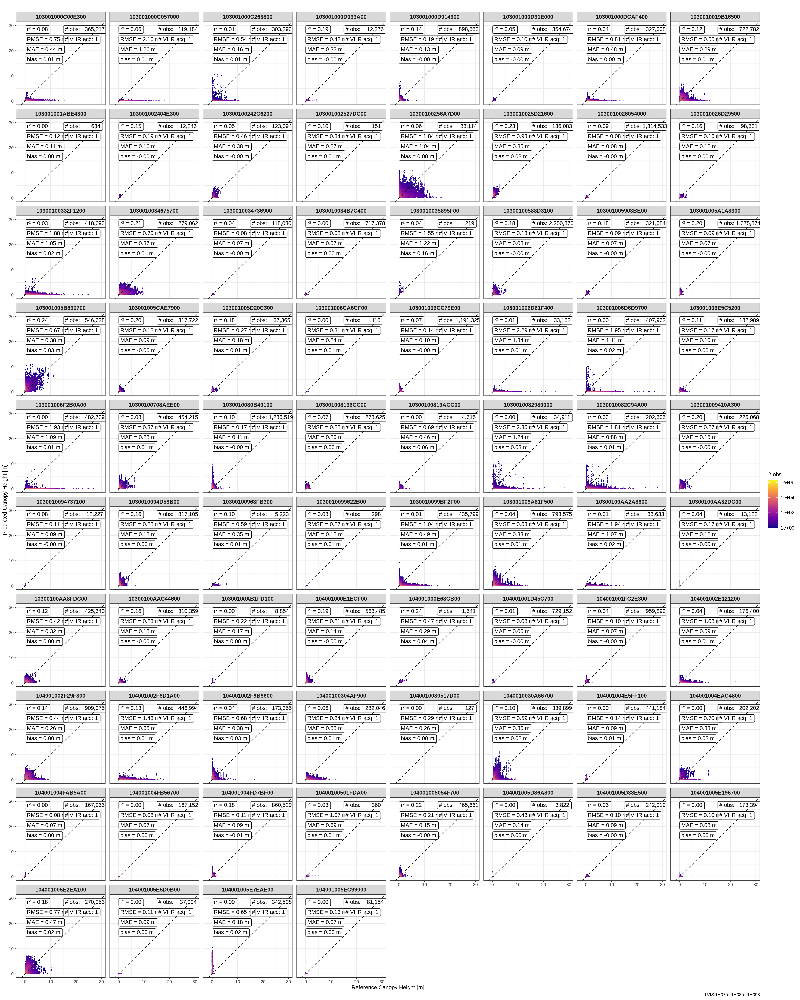

In [16]:
result <- plot_scatter_melt_3(
    df_val = df_val %>% filter(catid %in% bad_preds_catid_list) %>% slice_sample(prop = 1),
    sample_frac = 1,
    LIST_REF_VARS = c("ht_m_ref_RH075"),
    #FACET_VAR_LIST = c('tcc_class','slope_class', 'srlite_class', 'model_use_class'),
    FACET_VAR_LIST = c('catid'),
    use_facet_wrap = TRUE,
    facet_ncol = 8,  
    BASE_TEXT_SIZE = 10,
    LABEL_SIZE = 3.5, 
    SCALE_FACTOR = 1,
  dir_val_csv = paste0("ABoVE_Shrubs/validation/chm/dinov3/4.3.2.5/dm_10m/",CSV_SET),
  dir_val_plots = "/explore/nobackup/projects/above/misc/ABoVE_Shrubs/validation/chm/dinov3/4.3.2.5/dm_10m/plots"
)

In [22]:
bad_preds_catid_stats <- result$stats
bad_preds_catid_stats$catid[13]

[1] "10300100256A7D00"

In [24]:
footprints

file,footprint_name,path,area_km2,area_ha,type,catid,sensor,year,month,date,year_cat,month_cat,geom
<chr>,<chr>,<chr>,<dbl>,<dbl>,<chr>,<chr>,<chr>,<dbl>,<dbl>,<dttm>,<chr>,<chr>,<GEOMETRY [°]>


In [26]:
library(leaflet)
library(sf)

# Read the footprints GeoPackage
footprints <- st_read("/explore/nobackup/projects/above/misc/ABoVE_Shrubs/footprints/footprints_chm_20231014_chm_002m.gpkg") %>%
    #filter( (month > 6) & (month < 9)) %>%
    filter(catid == '10300100256A7D00')

# Transform to WGS84 (EPSG:4326) for Leaflet
footprints_wgs84 <- st_transform(footprints, 4326)

# Create leaflet map
leaflet(footprints_wgs84) %>%
  addProviderTiles(providers$Esri.WorldGrayCanvas) %>%
  addPolygons(
    fillColor = "blue",
    fillOpacity = 0.3,
    color = "darkblue",
    weight = 2,
    popup = ~paste0("CATID: ", catid, "<br>",
                    "Sensor: ", sensor, "<br>",
                    "Date: ", date)
  ) %>%
  addScaleBar(position = "bottomleft")

Reading layer `footprints_chm_20231014_chm_002m' from data source 
  `/panfs/ccds02/nobackup/projects/above/misc/ABoVE_Shrubs/footprints/footprints_chm_20231014_chm_002m.gpkg' 
  using driver `GPKG'
Simple feature collection with 1280 features and 13 fields
Geometry type: POLYGON
Dimension:     XY
Bounding box:  xmin: -178.7638 ymin: 51.30279 xmax: 176.1451 ymax: 71.52065
Geodetic CRS:  WGS 84


HTML widgets cannot be represented in plain text (need html)